# Pop Music Through the Ages: A CNN Model of Spectrograms

The objective of this project is to build a model that classifies songs from the Billboard Top 100 by decade.  To achieve this, I have used a convolutional neural network trained on spectograms obtained from 5 second clips from the middle of each song.  A spectrogram is a visual representation of the spectrum of sound frequencies.  By creating a "picture" of the sound, we are now able to take advantage of the power of convolutional neural networks, a method used in image classification. This model achieves an accuracy of 45% for identifying the correct decade and an accuracy of 85% for identifying plus or minus one decade.

<img src="MusicDecades.gif" alt="Drawing" style="width: 400px;"/>
(Image from http://oficialenglish.blogspot.com)

From this model, I've made some pretty cool insights about pop music through the ages.  Here are a few highlights:

* The seventies was the most distinctive music era.  (We all knew that already, right? One word: DISCO)
* Some songs that were ahead of their time were:
* Some songs that really exemplified their era were:
* Some songs that really nailed the "retro" feel were:


## Implementation

For this project, I used librosa for audio processing and keras for the convolutional neural networks.

In [2]:
%matplotlib inline
import librosa
from librosa.display import specshow
import os
import glob
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split, GroupKFold
from sklearn.metrics import confusion_matrix
import keras
from keras.models import Sequential, load_model
from keras.layers import Dense, Dropout, Activation, Flatten, Conv2D, Convolution2D, MaxPooling2D
from keras.layers.normalization import BatchNormalization
from keras.layers.advanced_activations import ELU
from keras.utils import np_utils
from keras import backend as K
from keras.optimizers import SGD
from keras.callbacks import EarlyStopping, ModelCheckpoint
from matplotlib import cm
import matplotlib.pyplot as plt
import seaborn
import IPython.display as ipd
import h5py as h5py

Using TensorFlow backend.


The dataset I used is a collection of the mp3 files of all of the Billboard Top 100 Lists from 1955 to 1916.

In [3]:
music_files = sorted(glob.glob('/Users/edatta/Desktop/MUSICZ/*/*.mp3'))

Spectrograms are visual representations of songs that show the spectrum of sound frequency.  Here, we calculate the log of the mel-scaled spectrograms from each audio file.

In [3]:
if os.path.exists('LogSpectograms.npy'):
    X = np.load('LogSpectograms.npy')

else:
    X = []
    for i,music_file in enumerate(music_files):
        if '/1_' in music_file:
            print(os.path.basename(os.path.dirname(music_file)))
        audio_time_series, sampling_rate = librosa.load(music_file)
    
        # Get middle 5 seconds of song
        length = len(audio_time_series)
        middle_index = int(length/2)
        song_middle = audio_time_series[middle_index-50000:middle_index+50000]
    
        # Calculate log spectrogram
        spectrogram = librosa.feature.melspectrogram(song_middle, sampling_rate)
        log_spectrogram = librosa.logamplitude(spectrogram)
        X.append(log_spectrogram)
    np.save('LogSpectograms.npy', np.asarray(X))

We can visualize these log mel-scaled spectrograms to get an idea of how they may differ according to song.  Below, we see a comparison of the log spectrogram image from clips from two very different songs, "The Twist" (the number one song from 1962) and "In Da Club" (the number one song from 2003). 

In [1]:
song_indices = [3284,7384]

for i,index in enumerate(song_indices):
    filename = music_files[index]
    parts = filename.split('_')
    song = parts[1]
    artist = parts[2].split('.')[0]
    yr = os.path.basename(os.path.dirname(filename))
    
    logS = X[index,:,:]
    specshow(logS, cmap='CMRmap', x_axis='time', y_axis='linear')
    
    audio_time_series, sampling_rate = librosa.load(filename)
    length = len(audio_time_series)
    middle_index = int(length/2)
    song_middle = audio_time_series[middle_index-50000:middle_index+50000]
    
    print(yr)
    print(song)
    print(artist)
    #ipd.display(ipd.Audio(song_middle, rate=sampling_rate))
    plt.show()

NameError: name 'music_files' is not defined

For use in the convolutional neural network, it is necessary to normalize the input array and reshape the array.

In [5]:
# Normalize log spectrograms and save as floats
X = np.asarray(X)
max_value = np.amax(X)
X = X.astype('float32')
X = X/max_value
np.save('Spectograms.npy', X)

# Reshape X for use with TensorFlow backend
img_rows = X.shape[1]
img_cols = X.shape[2]
if K.image_data_format() == 'channels_first':
    shape = (1, img_rows, img_cols)
else:  # channel_last
    shape = (img_rows, img_cols, 1)
X = X.reshape((X.shape[0],) + shape)

For the outputs, I obtain the decade for each of the music files.  For use in the convolutional neural network, I've encoded the outputs in a one hot array.  The function "get_Y_decade" is defined so that it is easy to convert easily from the one hot array back to the decade or chart position.  

In [6]:
if os.path.exists('Y_decade.npy'):
    Y = np.load('Y_decade.npy')
else:
    Y = []
    for i,music_file in enumerate(music_files):
        decade = (int(os.path.basename(os.path.dirname(music_file)))-1900)/10
        Y.append(decade)
    Y = np.asarray(Y)
    unique_values = np.unique(Y)
    Y = np_utils.to_categorical(Y,len(unique_values))
    Y = Y.astype(int)
    np.save('Y_decade.npy', Y_decade)  
    
def get_Y_decade(Y):
    Y_decade = np.argmax(Y,axis=1)
    Y_decade = (Y_decade*10)+1950
    return Y_decade

My data set includes music from 1900 to present day, but I will extract only the music files from the Billboard Top 100 charts (1955-present) and split into training, validation, and test sets.

In [7]:
# Only use music files from the Billboard Top 100 charts (1955-present) 
music_files = music_files[2643:]
X = X[2643:,:,:,:] 
Y = Y[2643:,5:] 

#X_train, X_test, Y_train, Y_test, music_files_train, music_files_test = train_test_split(X,Y,music_files,test_size=.33)
# Use the top 10 songs from each year as the test set (10% of the available data)
music_files_train = []
X_train = []
Y_train = []
music_files_test = []
X_test = []
Y_test = []

for i, music_file in enumerate(music_files):
    song_num = int(os.path.basename(music_file).split('_')[0])
    if song_num > 10:
        music_files_train.append(music_file)
        X_train.append(X[i,:,:,:])
        Y_train.append(Y[i,:])
    else:
        music_files_test.append(music_file)
        X_test.append(X[i,:,:,:])
        Y_test.append(Y[i,:])

X_train = np.asarray(X_train)
Y_train = np.asarray(Y_train)
X_test = np.asarray(X_test)
Y_test = np.asarray(Y_test)

# From the remaining data, split randomly into a training set and validation set (72% and 18% of data respectively)
X_train, X_valid, Y_train, Y_valid, music_files_train, music_files_valid = train_test_split(X_train,Y_train,music_files_train,test_size=.2)


Define the architecture of the convolutional neural network and train the model using cross validation.  The diagram below shows a similar architecture to the one I am using.  The model here has two convolutional layers, followed by a pooling layer.  The input is then flattened and there are two dense fully connected layers.  The output is obtained by using softmax to convert the probabilities into classes.  A rectifier (ReLu) function is used for activation.  Dropout layers randomly set certain input units to 0, which help prevent overfitting.
<img src="https://www.mathworks.com/content/mathworks/www/en/discovery/convolutional-neural-network/jcr:content/mainParsys/image_copy.adapt.full.high.jpg/1506591535706.jpg">
(Diagram from https://www.mathworks.com/discovery/convolutional-neural-network.html)

In [8]:
nb_classes = Y_train.shape[1]
shape = (X_train.shape[1],X_train.shape[2],1)
model = Sequential()
model.add(Conv2D(32, kernel_size=(3, 3), activation='relu', input_shape=shape))
model.add(Conv2D(64, (3, 3), activation='relu'))
model.add(MaxPooling2D(pool_size=(2, 2)))
model.add(Dropout(0.25))
model.add(Flatten())
model.add(Dense(128, activation='relu'))
model.add(Dropout(0.5))
model.add(Dense(nb_classes, activation='softmax'))

sgd = SGD(lr=0.1, decay=1e-6, momentum=0.9, nesterov=True)
model.compile(loss='categorical_crossentropy', optimizer='sgd', metrics=['accuracy'])
#model.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['accuracy'])

Now, train the model with cross validation.

In [12]:
if(os.path.exists('best_weights.hdf5')):
    model.load_weights('best_weights.hdf5')
else:
    checkpt = ModelCheckpoint('best_weights.hdf5', monitor='val_acc', verbose=1, save_best_only=True, mode='max')
    early = EarlyStopping(monitor='val_loss', min_delta=0, patience=2, verbose=0, mode='auto')
    callbacks = [checkpt, early]
    hist = model.fit(X_train, Y_train, validation_data=(X_valid, Y_valid), batch_size=32, nb_epoch=20, verbose=1, shuffle=True, callbacks=callbacks)
    model.load_weights                        

/Users/edatta/miniconda2/lib/python2.7/site-packages/keras/models.py:848: UserWarning: The `nb_epoch` argument in `fit` has been renamed `epochs`.
  warnings.warn('The `nb_epoch` argument in `fit` '


Train on 4404 samples, validate on 1101 samples
Epoch 1/20
4404/4404 [==============================] - 384s - loss: 1.7175 - acc: 0.2693 - val_loss: 1.5691 - val_acc: 0.3460
Epoch 2/20
4404/4404 [==============================] - 373s - loss: 1.5736 - acc: 0.3445 - val_loss: 1.4847 - val_acc: 0.3969
Epoch 3/20
4404/4404 [==============================] - 376s - loss: 1.5015 - acc: 0.3717 - val_loss: 1.4394 - val_acc: 0.3906
Epoch 4/20
4404/4404 [==============================] - 376s - loss: 1.4367 - acc: 0.3960 - val_loss: 1.3617 - val_acc: 0.4305
Epoch 5/20
4404/4404 [==============================] - 365s - loss: 1.3944 - acc: 0.4248 - val_loss: 1.3449 - val_acc: 0.4269
Epoch 6/20
4404/4404 [==============================] - 360s - loss: 1.3665 - acc: 0.4271 - val_loss: 1.3583 - val_acc: 0.4396
Epoch 7/20
4404/4404 [==============================] - 365s - loss: 1.3358 - acc: 0.4444 - val_loss: 1.3234 - val_acc: 0.4523
Epoch 8/20
4404/4404 [==============================] - 373s - 

Calculate the predicted decades and the probabilities used for prediction.  Also, calculate the accuracy of the model when evaluated on the test data.

In [14]:
score = model.evaluate(X_test, Y_test, verbose=1)
Y_predict = model.predict(X_test)
Y_predict_proba = model.predict_proba(X_test)

Y_test_decade = get_Y_decade(Y_test)
Y_predict_decade = get_Y_decade(Y_predict)

acc = score[1]
deltas = np.abs(Y_test_decade - Y_predict_decade)
deltas_within_10 = deltas[deltas<=10]
acc_within_10 = len(deltas_within_10)/float(len(deltas))
print('ACCURACY:')
print(acc)
print('ACUURACY WITHIN ONE DECADE')
print(acc_within_10)

620/620 [==============================] - 12s    
ACCURACY:
0.416129032258
ACUURACY WITHIN ONE DECADE
0.824193548387


The confusion matrix below shows how the convolutional neural network performs and where most of the errors occur.  From this confusion matrix, we can see that most misclassifications were made plus or minus one decade, which makes sense since music styles don't change magically at the decade mark.  For example, a song like " " was misclassified as --, even though it came out in --.  From this confusion matrix, we can see that the decade that was easiest to classify was ---- and the decade that was hardest to classify was ----.  We can therefore conclude that the ---- were the most distinctive era in pop music. 

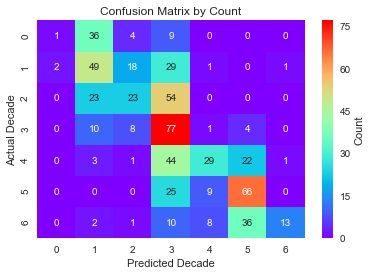

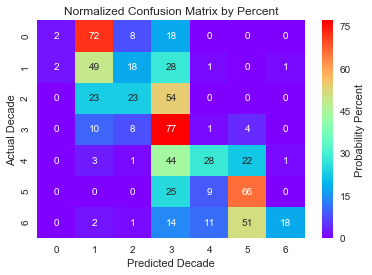

In [15]:
confusion = confusion_matrix(Y_test_decade, Y_predict_decade)
confusion_plt = seaborn.heatmap(confusion,cmap=cm.rainbow,cbar_kws={'label': 'Count'}, annot=True, fmt="d")
confusion_plt.set(xlabel='Predicted Decade', ylabel='Actual Decade')
confusion_plt.set_title('Confusion Matrix by Count')
plt.show()

normalized_confusion = confusion.astype('float') / confusion.sum(axis=1)[:, np.newaxis]
normalized_confusion = (normalized_confusion*100).astype(int)
confusion_plt = seaborn.heatmap(normalized_confusion,cmap=cm.rainbow,cbar_kws={'label': 'Probability Percent'}, annot=True, fmt="d")
confusion_plt.set(xlabel='Predicted Decade', ylabel='Actual Decade')
confusion_plt.set_title('Normalized Confusion Matrix by Percent')
plt.show()

### Let's now look at how the model performs on the whole data set to make some insights about songs!  

First, I'll print a table of all of the songs that were mistakenly classified by more than one decade.  The columns are the actual decades and the rows are the predicted decades.

In [16]:
music_files_test = np.asarray(music_files_test)
decades = np.unique(Y_test_decade).tolist()
target_df_list = []

for i, target in enumerate(decades):
    songnames = []
    artists = []
    probabilities = []
    
    for decade in decades:
        songs_from_decade = music_files_test[Y_test_decade == decade]
        predictions_for_songs_from_decade = Y_predict_decade[Y_test_decade == decade]
        probabilities_for_songs_from_decade = (np.asarray(Y_predict_proba))[Y_test_decade == decade,:]
        
        songs_classified_as_target = songs_from_decade[np.argwhere(predictions_for_songs_from_decade == target)]
        probabilities_for_songs_classified_as_target = np.squeeze(probabilities_for_songs_from_decade[np.argwhere(predictions_for_songs_from_decade == target)],axis=1)[:,i]
        
        if songs_classified_as_target.tolist():
            highest_probability_index = np.argmax(probabilities_for_songs_classified_as_target)
            highest_probability = probabilities_for_songs_classified_as_target[highest_probability_index]
            most_probable_song = songs_classified_as_target[highest_probability_index]
            
            songnames.append(os.path.basename(most_probable_song[0]).split('_')[1])
            artists.append(os.path.basename(most_probable_song[0]).split('_')[2].split('.')[0])
            probabilities.append(highest_probability)
        else:
            songnames.append('')
            artists.append('')
            probabilities.append(0)
        
    target_df = pd.DataFrame(index=decades,columns=['Song','Artist','Probability'])
    target_df['Song'] = songnames
    target_df['Artist'] = artists
    target_df['Probability'] = probabilities
    target_df_list.append(target_df)
confusion_df = pd.concat(target_df_list, keys=decades, axis=1)    
    
with pd.option_context('display.max_rows', None, 'display.max_columns', None, 'display.max_colwidth', -1):
    ipd.display(confusion_df)

1950                             \
                            Song         Artist Probability   
1950  Tequila                     Champs         0.584799     
1960  Can't Take My Eyes Off You  Frankie Valli  0.382973     
1970                                             0.000000     
1980                                             0.000000     
1990                                             0.000000     
2000                                             0.000000     
2010                                             0.000000     

                           1960                                \
                           Song            Artist Probability   
1950  Les Baxter                 Unchained Melody  0.793241     
1960  Theme From A Summer Place  Percy Faith       0.793709     
1970  One Hell Of A Woman        Mac Davis         0.689860     
1980  Coming Up                  Paul McCartney    0.558531     
1990  Goodbye England's Rose     Elton John        0.516375     
2000                                               0.000000     
2010  Me, Myself & I             G-Eazy            0.703453     

                       1970                                             1980  \
                       Song         Artist Probability                  Song   
1950  Roger Williams         Autumn Leaves  0.546422    Patricia               
1960  Travelin' Man          Rick Nelson    0.535312    Pony Time              
1970  Crocodile Rock         Elton John     0.609863    Boogie Oogie Oogie     
1980  Sweet Child O' Mine    Guns N' Roses  0.546004    Don't You Want Me      
1990  You Were Meant For Me  Jewel          0.382450    Nothing Compares 2 U   
2000                                        0.000000    Ridin'                 
2010  Royals                 Lorde          0.258603    Earned It              

                                                              1990  \
                              Artist Probability              Song   
1950  Perez Prado                     0.802721                       
1960  Chubby Checker                  0.866379    Good Lovin'        
1970  A Taste Of Honey                0.937122                       
1980  Human League                    0.934670    Abracadabra        
1990  Sinead O'Connor                 0.933803    Baby, Baby, Baby   
2000  Chamillionaire Ft Krayzie Bone  0.760230    Promiscuous        
2010  The Weeknd                      0.780411    Work               

                                                       2000                  \
                          Artist Probability           Song          Artist   
1950                              0.000000                                    
1960  The Young Rascals           0.394295                                    
1970                              0.000000                                    
1980  Steve Miller Band           0.464424    Miss You Much  Janet Jackson    
1990  TLC                         0.787230    Poison         Bell Biv Devoe   
2000  Nelly Furtado Ft Timbaland  0.500297    Bleeding Love  Leona Lewis      
2010  Rihanna                     0.986590    Need You Now   Lady Antebelum   

                                     2010                           
     Probability                     Song       Artist Probability  
1950  0.000000                                          0.000000    
1960  0.000000    I Can't Stop Loving You  Ray Charles  0.255771    
1970  0.000000                                          0.000000    
1980  0.557453                                          0.000000    
1990  0.877127    Jump                     Kris Kross   0.474990    
2000  0.893752                                          0.000000    
2010  0.837496    Rolling In The Deep      Adele        0.743972

Now, let's determine which songs the model was LEAST sure about.  I determine this by using the standard deviations of the probability arrays.  The arrays with smallest standard deviations are the ones where the probabilities for each class were more equal. 

I Can't Stop Loving You
Ray Charles
1962


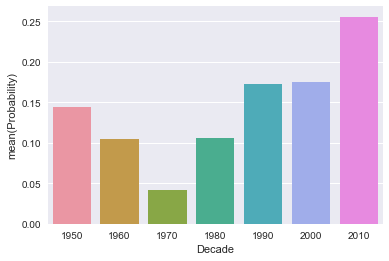

Fergalicious
Fergie
2007


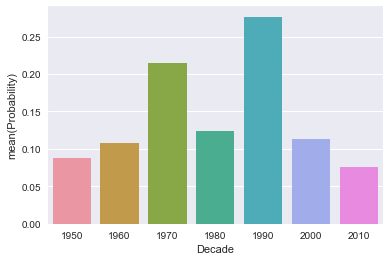

Love Yourself
Justin Bieber
2016


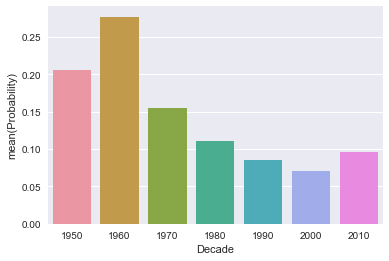

In [18]:
stdev = np.std(Y_predict_proba,axis=1)
sorted_indices = np.argsort(stdev)
songs_sorted_stdev = music_files_test[sorted_indices]
probabilities_sorted_stdev = Y_predict_proba[sorted_indices,:]
years_sorted = Y_test_decade[sorted_indices]
years_sorted

least_sure_songs = songs_sorted_stdev[:3].tolist()
least_sure_probabilities = probabilities_sorted_stdev[:10,:]
most_sure_songs = songs_sorted_stdev[-3:].tolist()
most_sure_probabilities = probabilities_sorted_stdev[-10:,:]
for i,song in enumerate(least_sure_songs):
    print(os.path.basename(song).split('_')[1])
    print(os.path.basename(song).split('_')[2].split('.')[0])
    print(os.path.basename(os.path.dirname(song)))
    ipd.display(ipd.Audio(song))
    probability_list = least_sure_probabilities[i,:]
    dictionary = {'Decade':np.asarray(decades), 'Probability':np.asarray(probability_list)}
    df = pd.DataFrame()
    df = df.from_dict(dictionary)
    seaborn.barplot(x='Decade', y='Probability', data=df)
    plt.show()

Now, let's determine which songs the model was MOST sure about.

Don't You Want Me
Human League
1982


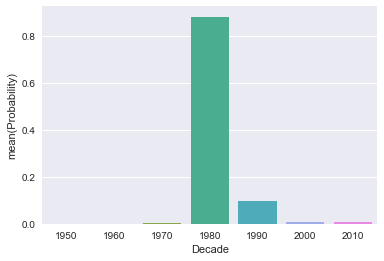

Boogie Oogie Oogie
A Taste Of Honey
1978


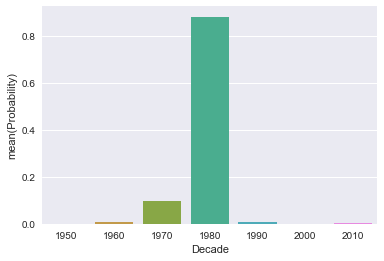

Work
Rihanna
2016


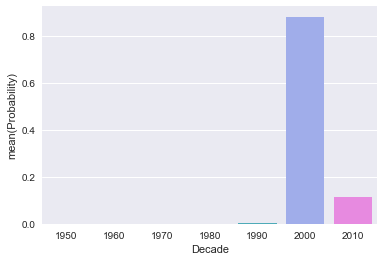

In [19]:
for i,song in enumerate(most_sure_songs):
    print(os.path.basename(song).split('_')[1])
    print(os.path.basename(song).split('_')[2].split('.')[0])
    print(os.path.basename(os.path.dirname(song)))
    ipd.display(ipd.Audio(song))
    probability_list = most_sure_probabilities[i,:]
    dictionary = {'Decade':np.asarray(decades), 'Probability':np.asarray(probability_list)}
    df = pd.DataFrame()
    df = df.from_dict(dictionary)
    seaborn.barplot(x='Decade', y='Probability', data=df)
    plt.show()

Here is a complete table of all of the songs classified, sorted by probability.